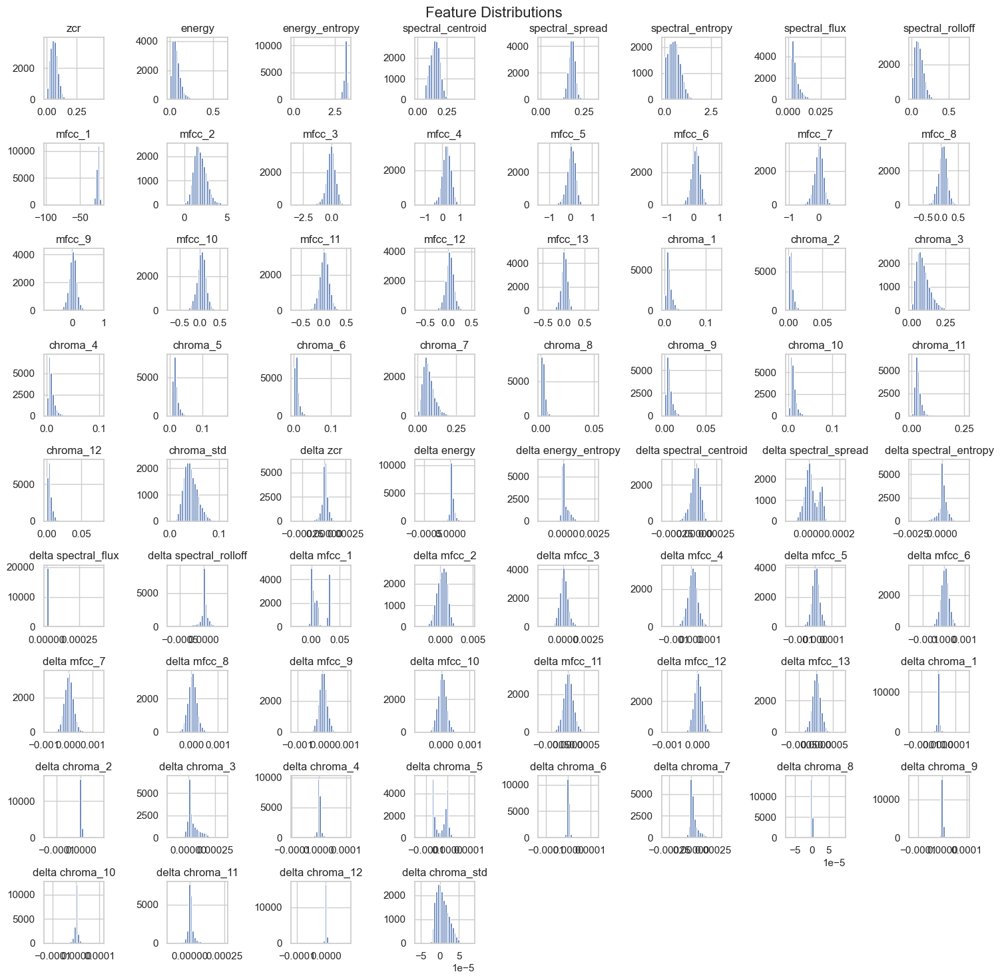

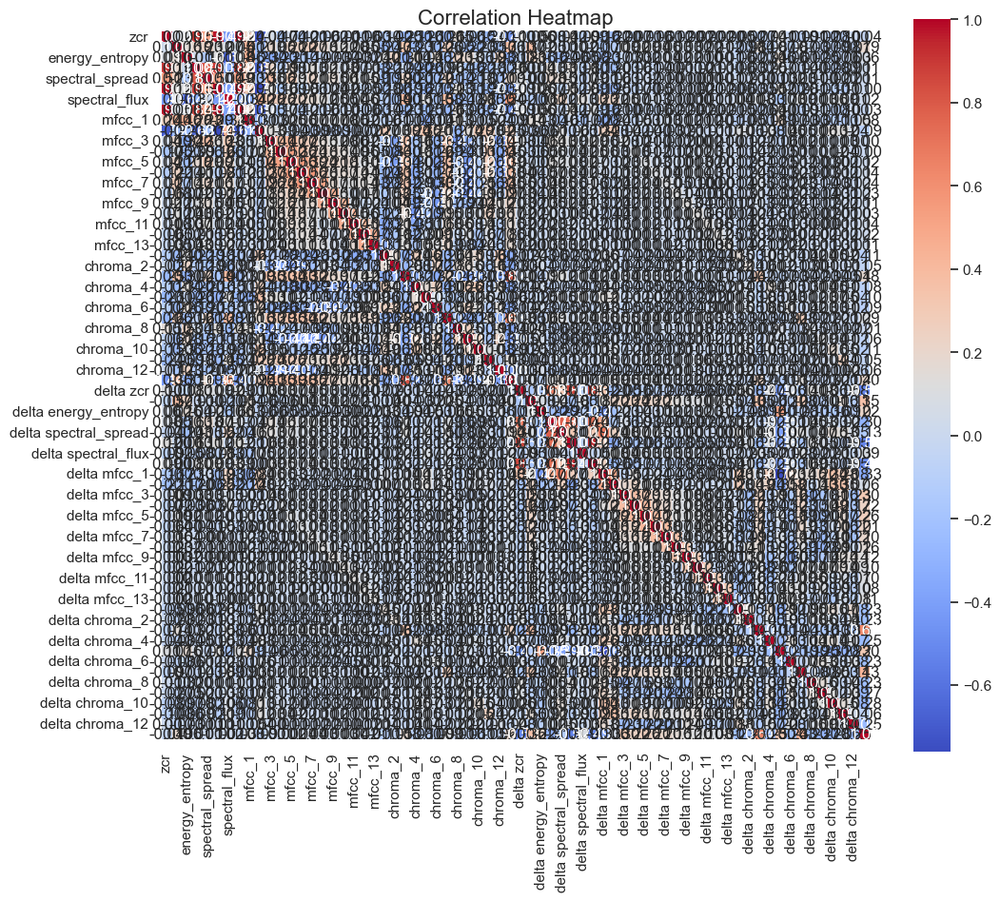

C:\Users\ashut\AppData\Local\Temp\ipykernel_27224\131253371.py:40: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='Genre', palette='Set2')


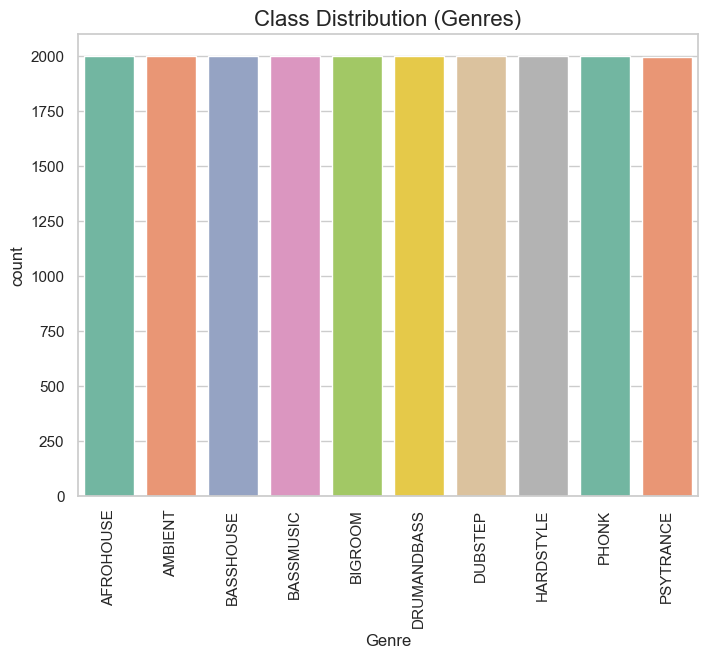

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset from the Excel file
input_filepath = r"C:\Users\ashut\Desktop\DATASET\TRAIN.xlsx"
df = pd.read_excel(input_filepath)

# Set up the visualization style
sns.set(style="whitegrid")

# 1. Visualizing the distribution of features
def plot_feature_distribution(df):
    # Get the list of features (exclude 'Genre' and 'File Name')
    features = [col for col in df.columns if col not in ['Genre', 'File Name']]

    # Plot histograms for each feature
    df[features].hist(bins=30, figsize=(15, 15))
    plt.suptitle('Feature Distributions', fontsize=16)
    plt.tight_layout()
    plt.show()

# 2. Checking the correlation between features
def plot_correlation_matrix(df):
    # Get the list of features (exclude 'Genre' and 'File Name')
    features = [col for col in df.columns if col not in ['Genre', 'File Name']]

    # Calculate the correlation matrix
    corr_matrix = df[features].corr()

    # Compute the linkage matrix for hierarchical clustering
    linkage = sch.linkage(corr_matrix, method='ward')
    
    # Create a clustering order based on the linkage
    cluster_order = sch.dendrogram(linkage, no_plot=True)['leaves']

    # Reorder the correlation matrix based on clustering
    corr_matrix = corr_matrix.iloc[cluster_order, cluster_order]

    # Plot the heatmap
    plt.figure(figsize=(16, 14))  # Increase the figure size
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', cbar=True, square=True, 
                xticklabels=corr_matrix.columns, yticklabels=corr_matrix.columns,
                linewidths=0.5, annot_kws={"size": 8})

    plt.title('Correlation Heatmap with Hierarchical Clustering', fontsize=18)
    plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
    plt.yticks(rotation=0)   # Keep y-axis labels horizontal
    plt.show()

# 3. Class distribution of the target variable 'Genre'
def plot_class_distribution(df):
    plt.figure(figsize=(8, 6))
    sns.countplot(data=df, x='Genre', palette='Set2')
    plt.title('Class Distribution (Genres)', fontsize=16)
    plt.xticks(rotation=90)
    plt.show()

# 4. Pairwise feature comparison (scatter plots)
def plot_pairwise_comparison(df):
    # Plot a pairplot for a subset of features
    features = [col for col in df.columns if col not in ['Genre', 'File Name']]
    sns.pairplot(df[features].sample(100), diag_kind='kde', plot_kws={'alpha':0.5})
    plt.suptitle('Pairwise Feature Comparison', fontsize=16)
    plt.show()

# Function to display all plots
def explore_data(df):
    plot_feature_distribution(df)
    plot_correlation_matrix(df)
    plot_class_distribution(df)
    plot_pairwise_comparison(df)

# Explore the dataset
explore_data(df)


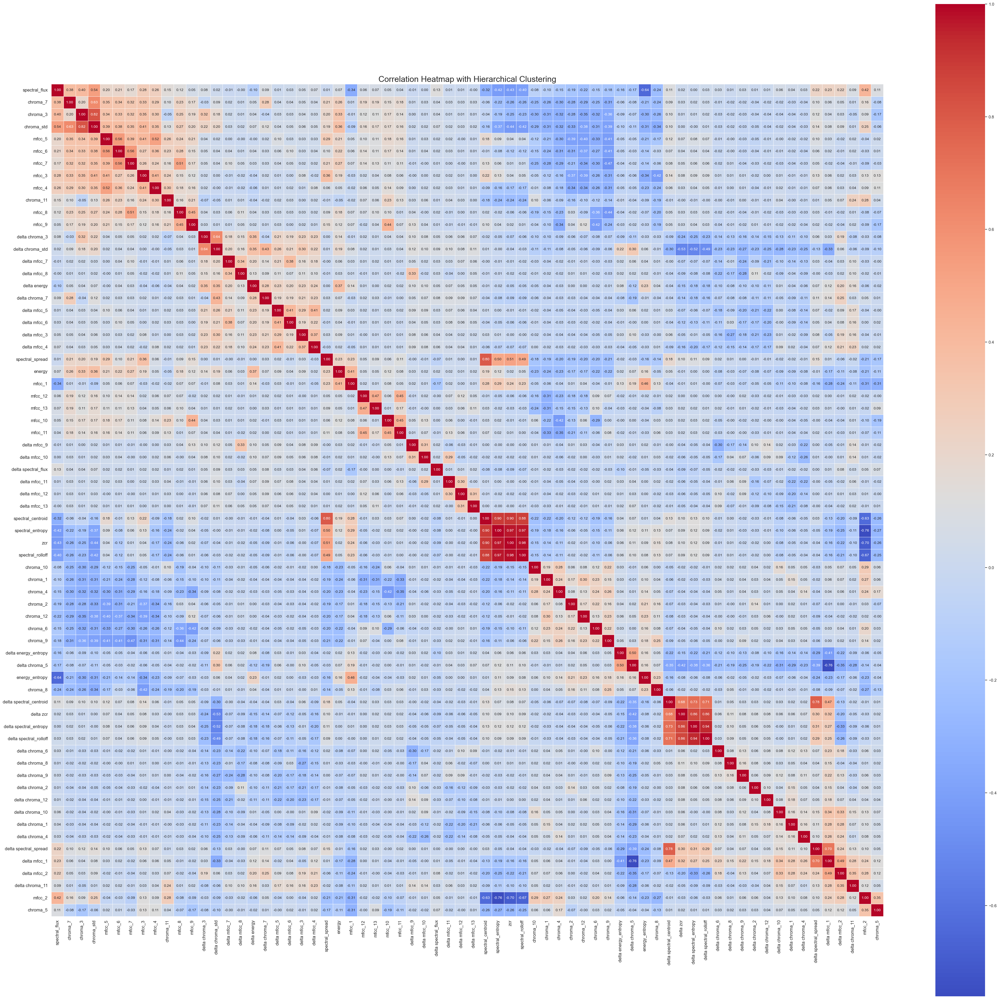

Heatmap saved to C:\Users\ashut\Desktop\DATASET\correlation_heatmap.png


In [7]:
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as sch

def plot_correlation_matrix(df):
    # Get the list of features (exclude 'Genre' and 'File Name')
    features = [col for col in df.columns if col not in ['Genre', 'File Name']]

    # Calculate the correlation matrix
    corr_matrix = df[features].corr()

    # Check if the correlation matrix is empty
    if corr_matrix.empty:
        print("Error: The correlation matrix is empty. Check the data.")
        return

    # Compute the linkage matrix for hierarchical clustering
    linkage = sch.linkage(corr_matrix, method='ward')
    
    # Create a clustering order based on the linkage
    cluster_order = sch.dendrogram(linkage, no_plot=True)['leaves']

    # Reorder the correlation matrix based on clustering
    corr_matrix = corr_matrix.iloc[cluster_order, cluster_order]

    # Plot the heatmap
    plt.figure(figsize=(50, 48))  # Increase the figure size significantly

    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', cbar=True, square=True, 
                xticklabels=corr_matrix.columns, yticklabels=corr_matrix.columns,
                linewidths=0.5, annot_kws={"size": 10})  # Adjust annotation font size

    plt.title('Correlation Heatmap with Hierarchical Clustering', fontsize=22)
    plt.xticks(rotation=90, fontsize=12)  # Rotate x-axis labels and increase font size
    plt.yticks(rotation=0, fontsize=12)   # Keep y-axis labels horizontal and increase font size

    # Save the figure at high resolution
    output_filepath = r"C:\Users\ashut\Desktop\DATASET\correlation_heatmap.png"
    plt.savefig(output_filepath, dpi=300, bbox_inches='tight')  # Save with high DPI

    # Show the plot
    plt.show()

    print(f"Heatmap saved to {output_filepath}")

# Example: Load the dataset and plot the correlation matrix
input_filepath = r"C:\Users\ashut\Desktop\DATASET\TRAIN.xlsx"
df = pd.read_excel(input_filepath)

# Call the function to plot the correlation matrix
plot_correlation_matrix(df)
